In [1]:
import sys
import os
import glob

sys.path.append("..")

import numpy as np
import matplotlib.pyplot as plt
import matplotlib as cm
import pandas as pd
import imageio
import cv2
import json

# import sarctra as srt
# from sarctra import deeptrack as dt

import deeptrack as dt

import tensorflow as tf

import logging

logging.disable(logging.WARNING)

/opt/miniconda3/envs/henv/lib/python3.9/site-packages/deeptrack/backend/_config.py:11: UserWarning: cupy not installed. GPU-accelerated simulations will not be possible
  warnings.warn(
/opt/miniconda3/envs/henv/lib/python3.9/site-packages/deeptrack/backend/_config.py:25: UserWarning: cupy not installed, CPU acceleration not enabled
  warnings.warn("cupy not installed, CPU acceleration not enabled")
/opt/miniconda3/envs/henv/lib/python3.9/site-packages/tensorflow_addons/utils/ensure_tf_install.py:53: UserWarning: Tensorflow Addons supports using Python ops for all Tensorflow versions above or equal to 2.8.0 and strictly below 2.11.0 (nightly versions are not supported). 
 The versions of TensorFlow you are currently using is 2.5.0 and is not supported. 
Some things might work, some things might not.
If you were to encounter a bug, do not file an issue.
If you want to make sure you're using a tested and supported configuration, either change the TensorFlow version or the TensorFlow Addo

In [39]:
# Output type
_OUTPUT_TYPE = "edges"

# Seach radius for the graph edges
radius = 0.01 # change

variables = dt.DummyFeature(
    radius=radius,
    # min_data_size=511,
    # max_data_size=512,
    # batch_size=8,
    output_type=_OUTPUT_TYPE,
    nofframes=10, # change
)

In [40]:
_LOAD_MODEL = False

model = dt.models.gnns.MAGIK(
    dense_layer_dimensions=(64, 96,),   # number of features in each dense encoder layer
    base_layer_dimensions=(96, 96, 96),        # Latent dimension throughout the message passing layers
    number_of_node_features=2,             # Number of node features in the graphs
    number_of_edge_features=1,             # Number of edge features in the graphs
    number_of_edge_outputs=1,              # Number of predicted features
    edge_output_activation="sigmoid",      # Activation function for the output layer
    output_type=_OUTPUT_TYPE,              # Output type. Either "edges", "nodes", or "graph"
)


# Compile model
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
    loss = 'binary_crossentropy',
    metrics=['accuracy'],
)
model.model.summary()

if _LOAD_MODEL:
    print("Loading model...")
    model.load_weights("../pre-trained-models/MAGIK.h5")
# else:
#     generator = srt.GraphGenerator(**variables.properties())
    
#     with generator:
#         model.fit(generator, epochs=10)

#     print("saving model...")
#     os.makedirs("models/", exist_ok=True)
#     model.save_weights("models/MAGIK.h5")



Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_9 (InputLayer)            [(None, None, 2)]    0                                            
__________________________________________________________________________________________________
node_ide1 (Dense)               (None, None, 64)     192         input_9[0][0]                    
__________________________________________________________________________________________________
layer (Layer)                   multiple             0           node_ide1[0][0]                  
                                                                 edge_ide1[0][0]                  
                                                                 node_ide2[0][0]                  
                                                                 edge_ide2[0][0]            

In [41]:
class NumpyEncoder(json.JSONEncoder):
    def default(self, obj):
        if isinstance(obj, np.ndarray):
            return obj.tolist()
        return json.JSONEncoder.default(self, obj)


def get_annonations(idx, positions):
    annonation = {
        "idx": idx,
        "length": np.shape(positions)[0],
        "coordinates": positions,
    }
    return annonation

In [42]:
from utils import load_video
FRAMES_PATH = "../original-videos/Plankton1.mp4"
frames = load_video(FRAMES_PATH, end=100)
frames.shape

loading frames: 100%|██████████| 100/100 [00:13<00:00,  7.62it/s]


(100, 1080, 1920, 3)

In [43]:
# json_path = '/Users/harshithbachimanchi/Desktop/sarcoma-project-seg-results/C_7.5HourRunBFandGFPevery3min/detections.json'
# dfs = srt.create_df_sarcoma(
#     path = json_path,
#     scaling=512
# )

In [44]:
DATA_PATH = "../detections/lodestar-detections-plankton1.npy"
# DATA_PATH = "/Volumes/HB_Work2/3-MagikPlankton/Position_Data/PositionsData_220211_Oxyrrhis.npy"
from utils import create_df_planktons
dfs = create_df_planktons(
    path = DATA_PATH,
    no_frames=[100],
    scaling_x=1080,
    scaling_y=1920,
)

In [45]:
dfs

,centroid-0,centroid-1,frame,solution,set,label
0,0.021127,0.513277,0,0,0,0
1,0.020959,0.968239,0,0,0,0
2,0.021515,0.954192,0,0,0,0
3,0.036856,0.958296,0,0,0,0
4,0.120047,0.488477,0,0,0,0
...,...,...,...,...,...,...
4198,0.899547,0.804170,99,0,0,0
4199,0.922263,0.582537,99,0,0,0
4200,0.937405,0.311198,99,0,0,0
4201,0.969869,0.108264,99,0,0,0


In [46]:
print(dfs["centroid-1"].max(), dfs["centroid-1"].min())
print(dfs["centroid-0"].max(), dfs["centroid-0"].min())

0.9876008987426758 0.00944006045659383
0.9818196614583333 0.01656757460700141


In [47]:
# pred, gt, scores, graph = dt.models.gnns.get_predictions(
#     dfs, ["centroid"], model, variables
# )

In [48]:
pred, gt, scores, graph = dt.models.gnns.get_predictions(
    dfs, ["centroid"], model, **variables.properties()
) 

Creating graph edges...


100%|██████████| 1/1 [00:15<00:00, 15.22s/it]


In [49]:
edges_df, nodes, _ = dt.models.gnns.df_from_results(pred, gt, scores, graph)

# display the first 10 rows of the dataframe
edges_df.head(10)

,frame_x,frame_y,node_x,node_y,gt,prediction,score,frame_diff
0,0.0,1.0,0.0,40.0,1.0,0.0,0.485117,1.0
1,0.0,1.0,2.0,42.0,1.0,1.0,0.503412,1.0
2,0.0,1.0,6.0,44.0,1.0,1.0,0.597615,1.0
3,0.0,1.0,7.0,43.0,1.0,1.0,0.704649,1.0
4,0.0,1.0,8.0,45.0,1.0,1.0,0.631620,1.0
5,0.0,1.0,9.0,46.0,1.0,1.0,0.592695,1.0
6,0.0,1.0,10.0,47.0,1.0,1.0,0.656548,1.0
7,0.0,1.0,11.0,50.0,1.0,1.0,0.612313,1.0
8,0.0,1.0,12.0,49.0,1.0,1.0,0.653573,1.0
9,0.0,1.0,13.0,54.0,1.0,1.0,0.740804,1.0


In [50]:
traj = dt.models.gnns.get_traj(edges_df, th = 2)

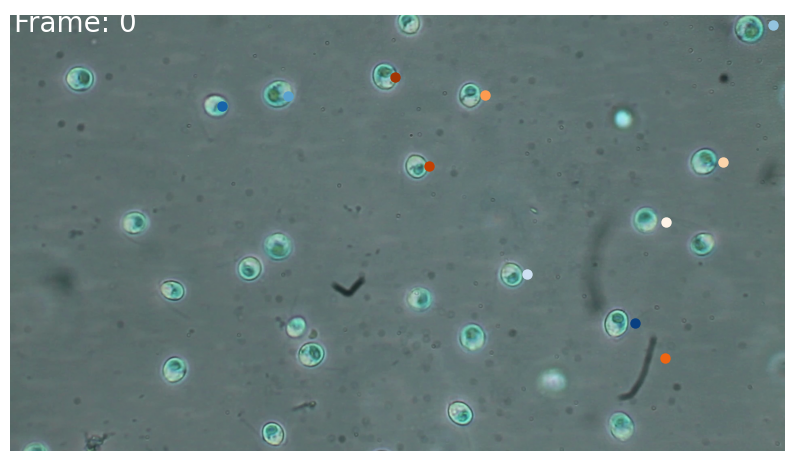

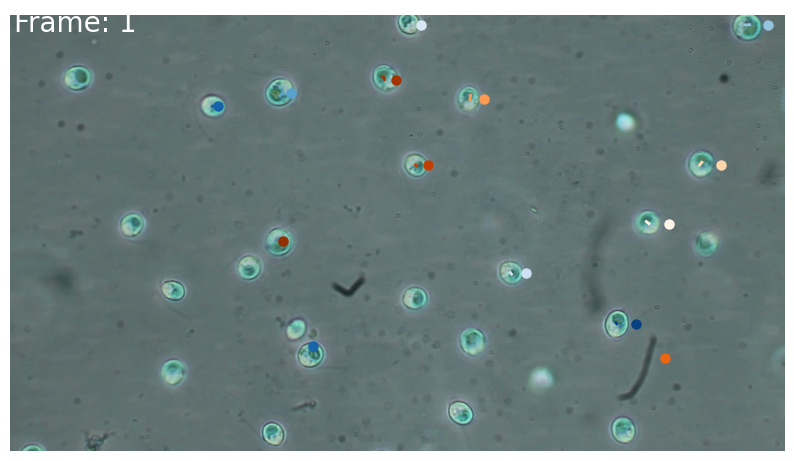

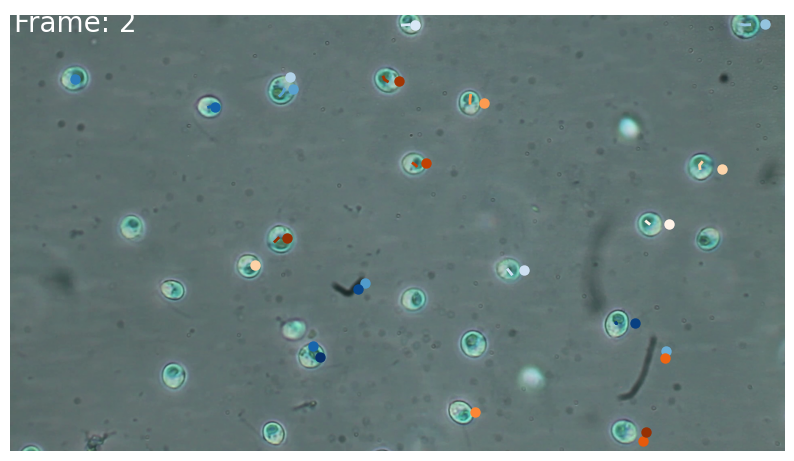

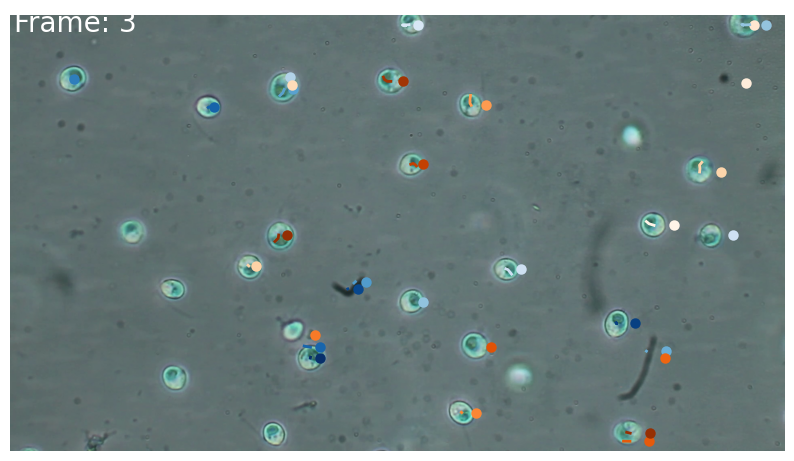

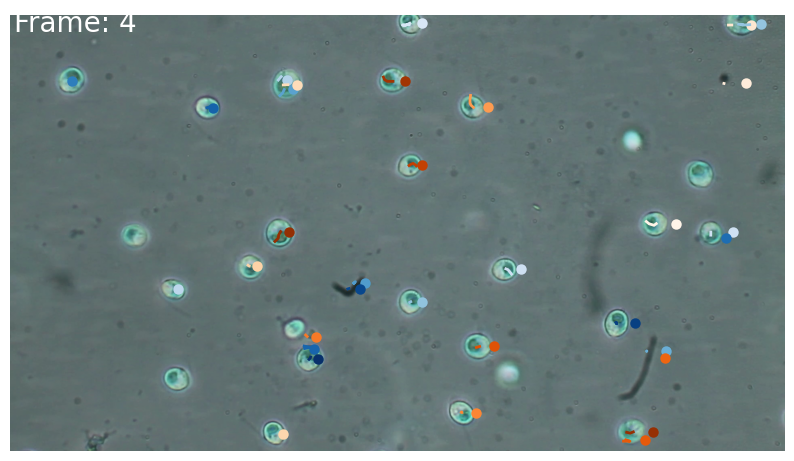

...

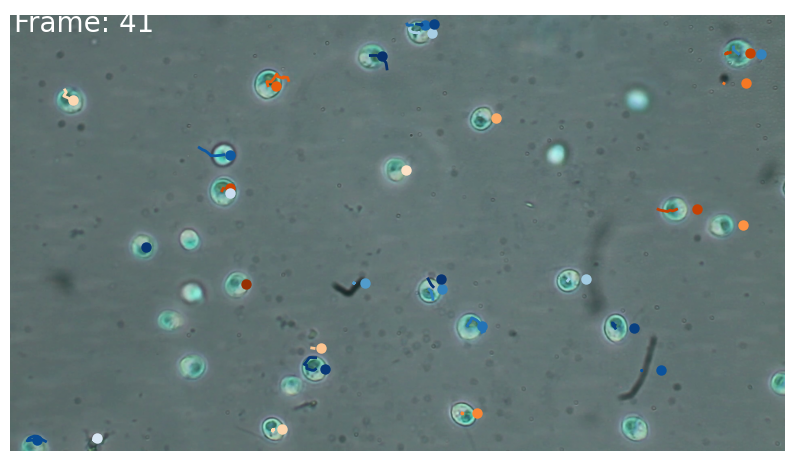

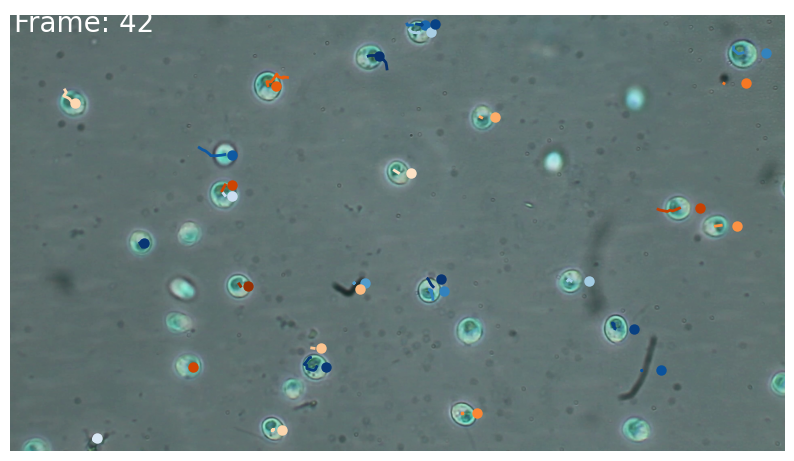

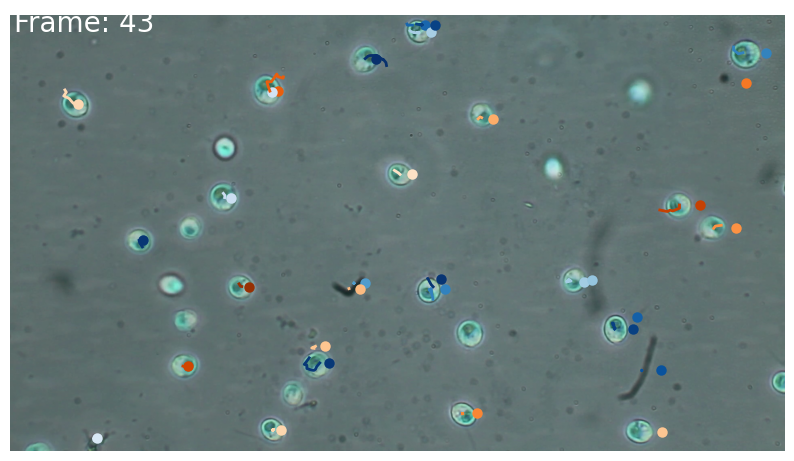

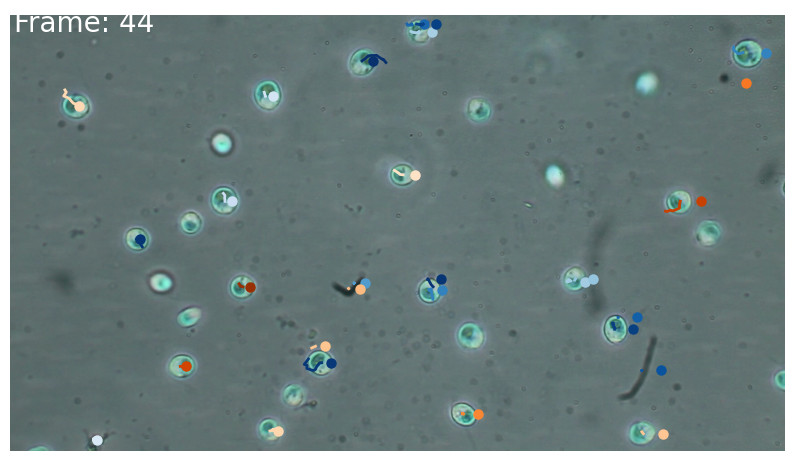

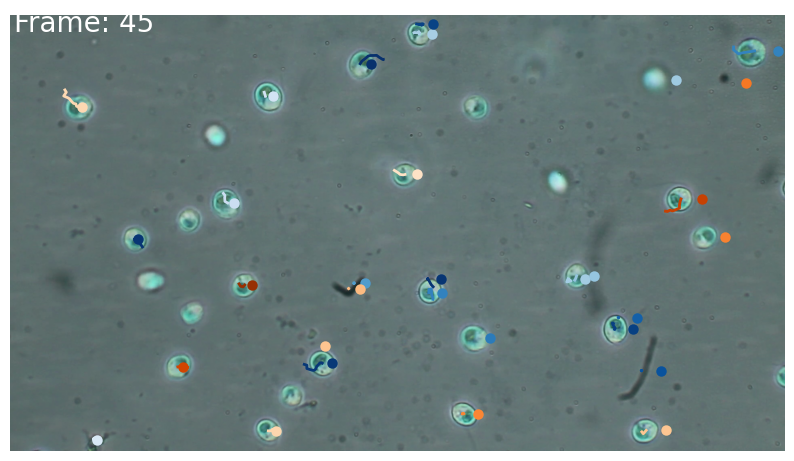

KeyboardInterrupt: 

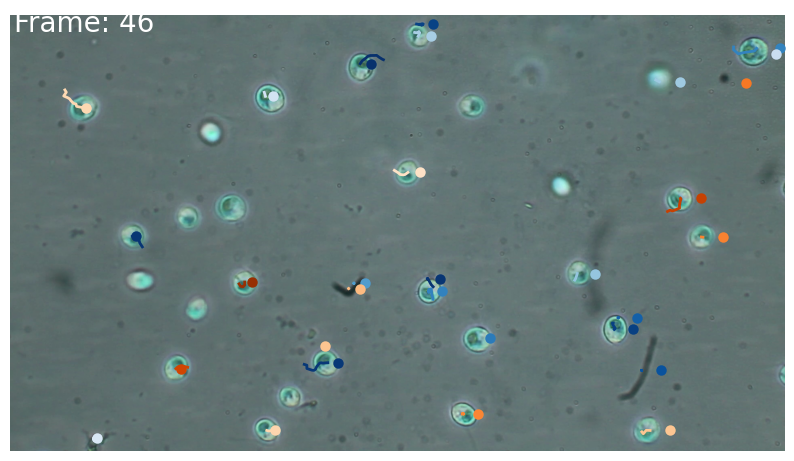

In [51]:
import glob
import cv2

import matplotlib.pyplot as plt

# frames = glob.glob("datasets/CellMigDataset/images/*.tif")[0:10]

for f, frame in enumerate(frames):
    # img = cv2.imread(frame, -1)
    img = frame

    fig = plt.figure(figsize=(10, 10))
    plt.imshow(img)
    plt.text(10, 40, "Frame: " + str(f), fontsize=20, c="white")
    plt.axis("off")

    for i, (t, c) in enumerate(traj):
        detections = nodes[t][(nodes[t, 0] <= f) & (nodes[t, 0] >= f - 10), :]

        if (len(detections) == 0) or (np.max(nodes[t, 0]) < f):
            continue

        plt.plot(detections[:, 2] * 1920, detections[:, 1] * 1080, color = c, linewidth=2)
        plt.scatter(detections[-1, 2] * 1980, detections[-1, 1] * 1080, linewidths=1.5, c = c)
    
    plt.show()

KeyboardInterrupt: 

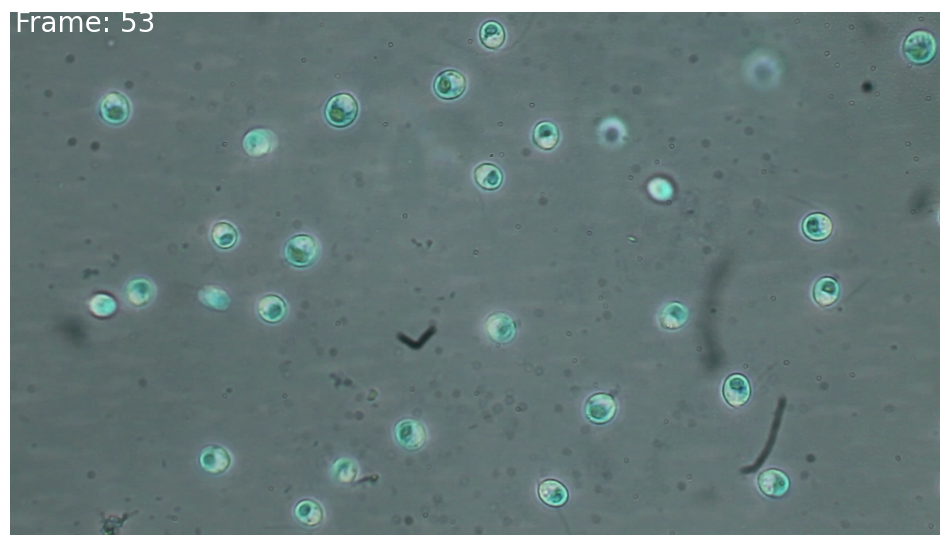

In [24]:
FOLDER_PATH = "../results/"

for frame, v in enumerate(frames):

    fig = plt.figure(figsize=(12, 8))
    plt.imshow(v, cmap='gray')
    plt.text(10, 40, "Frame: " + str(frame), fontsize=20, c="white")
    plt.axis('off')

    for i, (t, c) in enumerate(traj):
        detections = nodes[t][(nodes[t, 0] <= frame) & (nodes[t, 0] >= frame - len(frames)), :]

        if (len(detections) == 0) or (np.max(nodes[t, 0]) < frame):
            continue

        plt.plot(detections[:, 1] * 1080, detections[:, 2] * 1920, color = 'red', linewidth=2)
        #plt.plot(detections[-1, 1] * 1280, detections[-1, 2] * 1024,  marker = 'o', markersize=10, markeredgewidth = 2, markeredgecolor = c) #edgecolors=c)

    plt.savefig(FOLDER_PATH + "_f_" + str(frame) + ".png")
    plt.close(fig)

In [13]:
trajectories = sorted(glob.glob(folder_path), key=os.path.getmtime)

In [14]:
trajectories

['/Users/harshithbachimanchi/Desktop/sarcoma-project-seg-results/C_7.5HourRunBFandGFPevery3min/traces/']

In [20]:
import imageio

trajectories = sorted(glob.glob(folder_path), key=os.path.getmtime)

for i, folder in enumerate(trajectories):
    frames = glob.glob(folder +"/*.png")
    frames.sort(key=os.path.getmtime)

    writer = imageio.get_writer(
        folder_path+ 'trace_video' + ".mov", 
        fps=10,  codec='mjpeg', quality=10#, pixelformat='yuvj444p'
    )

    for frame in frames:
        # read image
        img = cv2.imread(frame)
        writer.append_data(img)
    
    writer.close()

Incompatible pixel format 'yuv420p' for codec 'mjpeg', auto-selecting format 'yuvj420p'
[swscaler @ 0x7fa48e2c6000] deprecated pixel format used, make sure you did set range correctly
